In [1]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append('../coral')
sys.path.append('../')

import utils_HCC, visium_codex_process
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random 
import scipy
import seaborn as sns

from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
from torch.utils.data import DataLoader, TensorDataset,ConcatDataset
from scipy.stats import zscore

from sklearn.neighbors import KDTree,NearestNeighbors
from coral import coral_main, VisCoxDataset, utils, utils_exp, utils_simu
from scipy.spatial import cKDTree

import scanpy as sc
import anndata
import torch

import os

In [2]:
import matplotlib as mpl
# Set the font family to DejaVuSans or another font with full sentence support
mpl.rcParams['pdf.fonttype'] = 42  # Ensures text is stored as Type 3 font (OpenType)
mpl.rcParams['ps.fonttype'] = 42  # PostScript font type for compatibility


In [3]:
adata1 = sc.read_h5ad('/hpc/mydata/siyu.he/Siyu_projects/coral_storage/coral_results/hcc_results/data_0_preprossed.h5ad')
adata2 = sc.read_h5ad('/hpc/mydata/siyu.he/Siyu_projects/coral_storage/coral_results/hcc_results/data_1_preprossed.h5ad')
adata3 = sc.read_h5ad('/hpc/mydata/siyu.he/Siyu_projects/coral_storage/coral_results/hcc_results/data_2_preprossed.h5ad')
adata4 = sc.read_h5ad('/hpc/mydata/siyu.he/Siyu_projects/coral_storage/coral_results/hcc_results/data_3_preprossed.h5ad')


In [4]:
adata1.obsm['generated_expr'].shape

(15910, 1076)

In [5]:
cell_type_label_mapping = {'Neutrophils': 0,
 'Macrophages': 1,
 'B cells': 2,
 'CD4 T cells': 3,
 'Stroma Uncharacterized': 4,
 'INFg+': 5,
 'Macrophages M2-like': 6,
 'Fibroblasts': 7,
 'Endothelial cells': 8,
 'Tumor Inos': 9,
 'Tumor': 10,
 'CD8 T cells': 11,
 'Dendritic cells': 12,
 'Unknown': 13}
reversed_mapping = {v: k for k, v in cell_type_label_mapping.items()}

select_gene = np.load('../../HCCproject3/select_gene.npy',allow_pickle=True)
pg_dist = utils_HCC.return_protein_to_gene()
select_gene = np.append(select_gene,[pg_dist[i] for i in pg_dist.keys()])
select_gene = np.unique(select_gene)

cell_type_marker = pd.read_csv('bc_signatures_version_1013.csv')



In [8]:
adata_all = sc.concat([adata1,adata2,adata3,adata4])
adata_all.obs['niche_classify_major'] = [i.split('-')[0] for i in adata_all.obs['niche_classify']]
adata_all_immune = adata_all[adata_all.obs['codex_type_label'].isin(['Macrophages','Macrophages M2-like'])].copy()

adata_all_immune_scRNA = anndata.AnnData(adata_all_immune.obsm['generated_expr'])
adata_all_immune_scRNA.obs = adata_all_immune.obs
adata_all_immune_scRNA.obsm = adata_all_immune.obsm
adata_all_immune_scRNA.var_names = select_gene
adata_all_immune_scRNA.raw = adata_all_immune_scRNA

#sc.pp.normalize_total(adata_all_immune_scRNA)
#sc.pp.log1p(adata_all_immune_scRNA)
sc.tl.pca(adata_all_immune_scRNA)
sc.pp.neighbors(adata_all_immune_scRNA)
sc.tl.umap(adata_all_immune_scRNA)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(-10.341911125183106,
 20.922340202331544,
 -12.425115489959717,
 22.154655361175536)

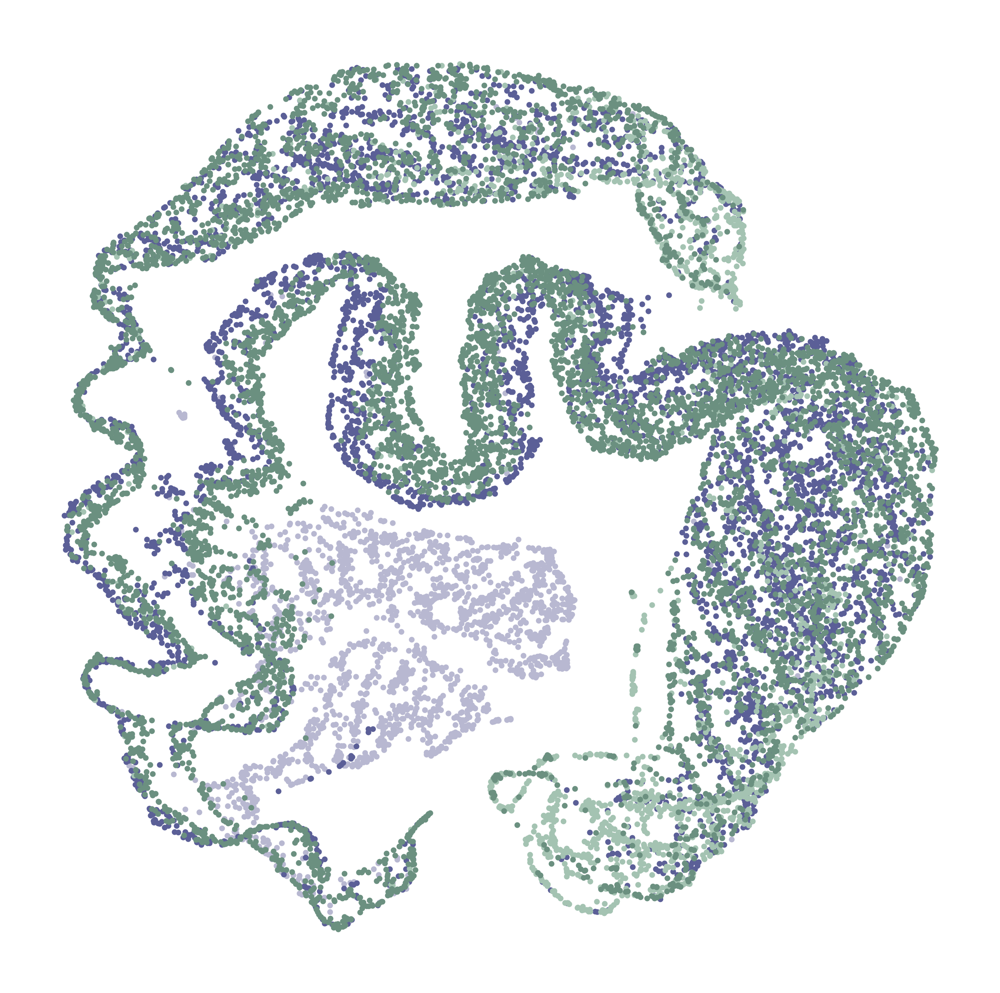

In [9]:
plt.figure(dpi=500,figsize=(6,6))
color_list = {'data1':'#B8B8D1',
              'data2':'#5B5F97',
              'data3':'#A4C3B2',
              'data4':'#6B9080'}

for j,i in enumerate(adata_all_immune_scRNA.obs['sample'].unique()):
    plt.scatter(adata_all_immune_scRNA.obsm['X_umap'][adata_all_immune_scRNA.obs['sample']==i,0],
                adata_all_immune_scRNA.obsm['X_umap'][adata_all_immune_scRNA.obs['sample']==i,1],
                c = color_list[i],
                s=1
               )
plt.axis('off')

In [10]:
sc.tl.leiden(adata_all_immune_scRNA,resolution=0.05)
adata_all_immune_scRNA.obs.leiden.unique()

/tmp/ipykernel_3473028/3748781682.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_all_immune_scRNA,resolution=0.05)


['6', '7', '2', '5', '1', '3', '0', '4']
Categories (8, object): ['0', '1', '2', '3', '4', '5', '6', '7']

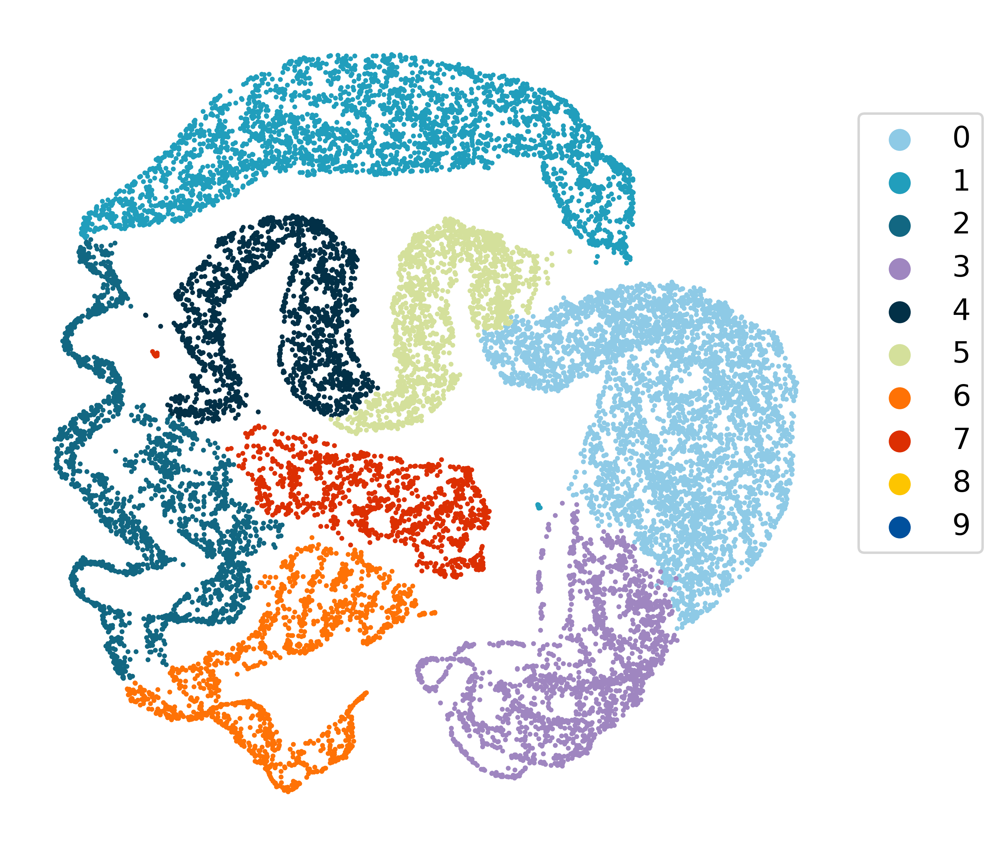

In [11]:
plt.figure(dpi=500,figsize=(6,6))
color_list =['#8ecae6',
            '#219ebc',
            '#126782',
            '#9f86c0',              
            '#023047',                     
            '#d4e09b',
            '#FE7206',
            '#dc2f02',                                                
            '#fdc500',
            '#00509d',  
            '#ffc9b9',   
            '#affc41', 
            '#3454D1',
            '#3E8914',
            '#FE64A3',
            '#6320EE',
            '#26F0F1',
            '#F25C54'
            ]
for j,i in enumerate(['0', '1', '2', '3', '4','5','6','7','8','9',]):
    plt.scatter(adata_all_immune_scRNA.obsm['X_umap'][adata_all_immune_scRNA.obs['leiden']==i,0],
                adata_all_immune_scRNA.obsm['X_umap'][adata_all_immune_scRNA.obs['leiden']==i,1],
                c = color_list[j],
                s=1
               )
plt.axis('off')

plt.legend(['0', '1', '2', '3', '4','5','6','7','8','9',],bbox_to_anchor=(1.2,0.9),markerscale=8,
           scatterpoints=1,fontsize=12)

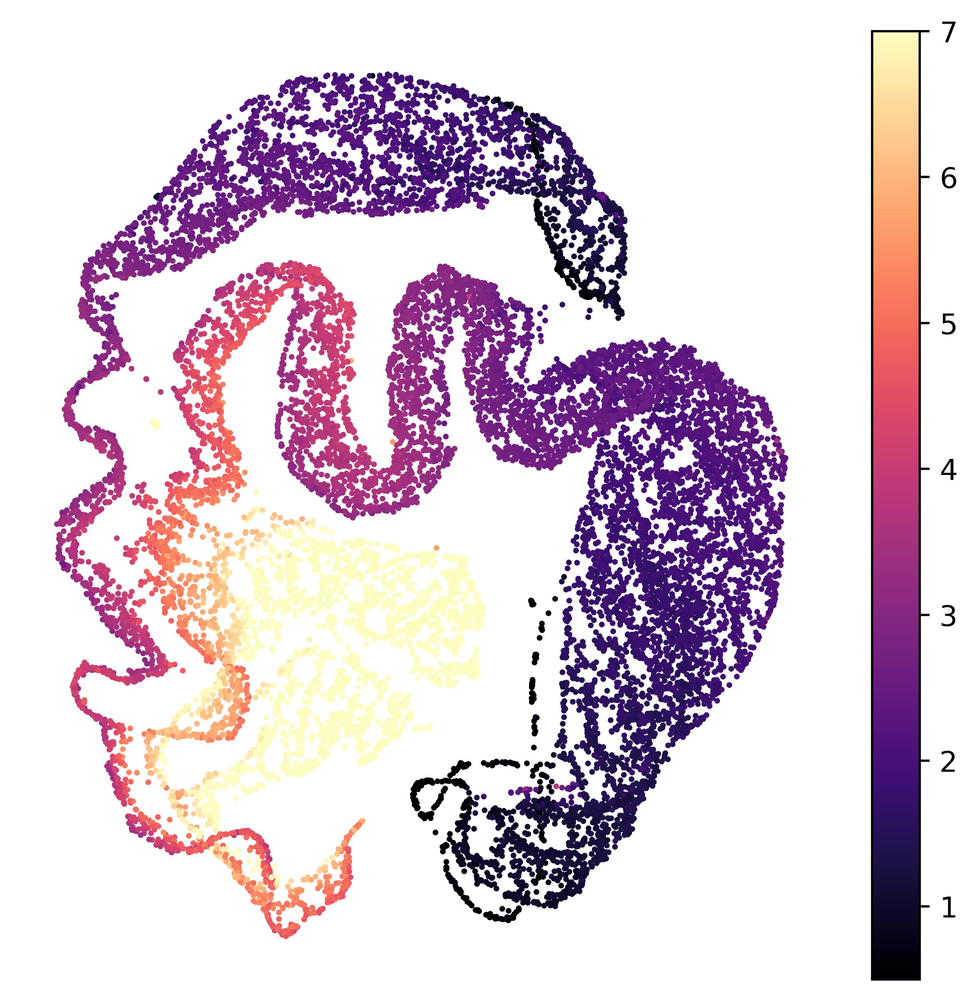

In [15]:
plt.figure(dpi=500,figsize=(6.3,6))
plt.scatter(adata_all_immune_scRNA.obsm['X_umap'][:,0],
            adata_all_immune_scRNA.obsm['X_umap'][:,1],
            c = adata_all_immune_scRNA[:,'CD163'].to_df().values,
            cmap='magma',
            vmin=0.5,
            vmax=7,
            s=1
           )
plt.axis('off')
plt.colorbar()

In [16]:
#adata_all_immune_scRNA = adata_all_immune_scRNA[adata_all_immune_scRNA.obs.niche_classify!='Tumor_niche_14'].copy()

In [17]:
sc.tl.rank_genes_groups(adata_all_immune_scRNA, groupby="leiden",method="wilcoxon")
adata_all_immune_scRNA.layers["scaled"] = sc.pp.scale(adata_all_immune_scRNA, copy=True).X
sc.set_figure_params(dpi=800,figsize=(4,2.5))
sc.tl.dendrogram(adata_all_immune_scRNA, groupby='sample')
sc.pl.rank_genes_groups_matrixplot(
    adata_all_immune_scRNA, 
    n_genes=3, 
    #dendrogram=False,
    use_raw=False, 
    vmin=-1.5, 
    vmax=1.5, 
    cmap="RdBu_r", 
    layer="scaled"
)
marker_genes_dict=['CD163','CD274','PDCD1','CXCL9','CXCL10','CXCL11','CCL2',
                   'CXCL1','CXCL2','CXCL3','CXCL5',
                   'CXCL8','IL1B','IL18','CCL15','CCL16',
                   'CCR7','CXCL13','IL7R']

sc.pl.dotplot(adata_all_immune_scRNA, 
              marker_genes_dict, 
              "leiden", 
              cmap="PiYG_r", 
              layer="scaled",
              vmin=-1,
              vmax=1,
              dendrogram=False)

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [18]:
import decoupler as dc
progeny = dc.get_progeny(organism='human', top=500)
progeny
dc.run_mlm(
    mat=adata_all_immune_scRNA,
    net=progeny,
    source='source',
    target='target',
    weight='weight',
    verbose=True
)
adata_all_immune_scRNA.obsm['progeny_mlm_estimate'] = adata_all_immune_scRNA.obsm['mlm_estimate'].copy()
adata_all_immune_scRNA.obsm['progeny_mlm_pvals'] = adata_all_immune_scRNA.obsm['mlm_pvals'].copy()
adata_all_immune_scRNA
acts = dc.get_acts(adata_all_immune_scRNA, obsm_key='mlm_estimate')
acts
sc.pl.matrixplot(acts, var_names=acts.var_names, groupby='leiden', dendrogram=True, standard_scale='var',
                 colorbar_title='Z-scaled scores', cmap='coolwarm')


KeyboardInterrupt: 

In [58]:
import decoupler as dc
msigdb = dc.get_resource('MSigDB')
# Filter by hallmark
msigdb = msigdb[msigdb['collection']=='hallmark']
msigdb = msigdb[~msigdb.duplicated(['geneset', 'genesymbol'])]

dc.run_ora(
    mat=adata_all_immune_scRNA,
    net=msigdb,
    source='geneset',
    target='genesymbol',
    verbose=True
)

acts = dc.get_acts(adata_all_immune_scRNA, obsm_key='ora_estimate')

# We need to remove inf and set them to the maximum value observed
acts_v = acts.X.ravel()
max_e = np.nanmax(acts_v[np.isfinite(acts_v)])
acts.X[~np.isfinite(acts.X)] = max_e


Running ora on mat with 16709 samples and 1076 targets for 35 sources.


  0%|          | 0/16709 [00:00<?, ?it/s]

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [59]:
df = dc.rank_sources_groups(acts, groupby='leiden', reference='rest', method='t-test_overestim_var')
n_markers = 3

source_markers = df.groupby('group').head(n_markers).groupby('group')['names'].apply(lambda x: list(x)).to_dict()
sc.pl.dotplot(acts, source_markers, 'leiden', dendrogram=True, standard_scale='var',
                 colorbar_title='Z-scaled scores', cmap='RdBu_r')

/tmp/ipykernel_1823929/1645701343.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = adata_all_immune_scRNA.obs.groupby(['niche_classify','leiden']).size().unstack(fill_value=0)


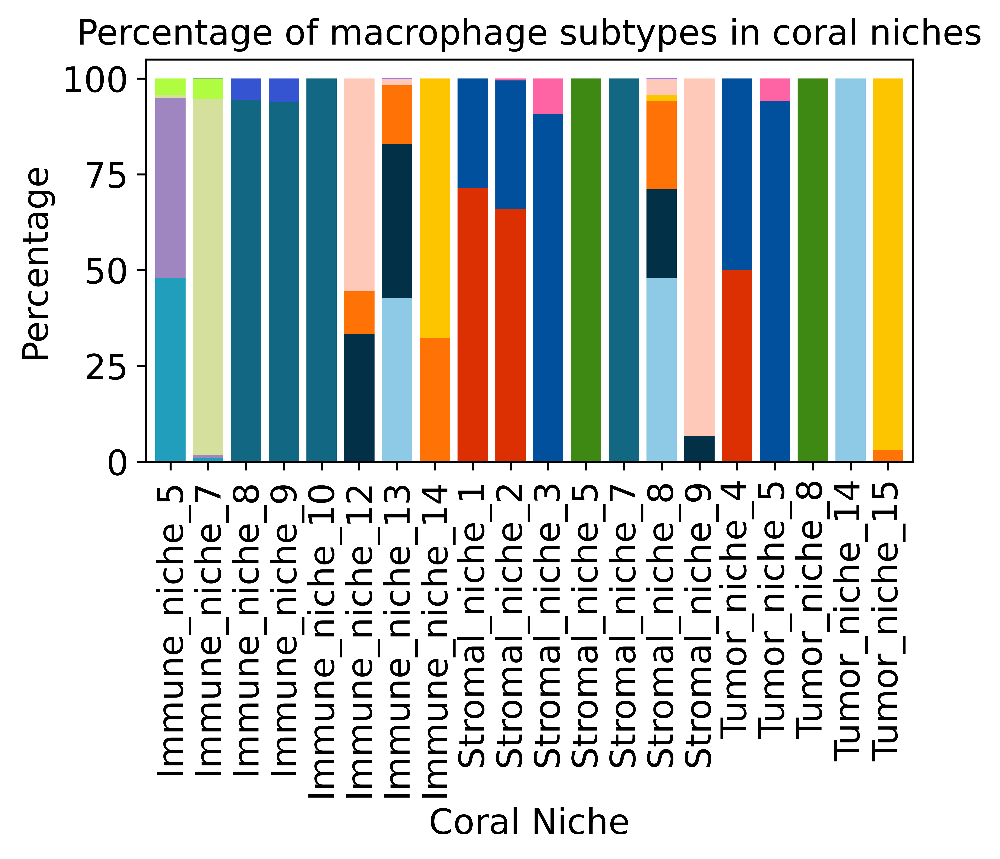

In [32]:
grouped = adata_all_immune_scRNA.obs.groupby(['niche_classify','leiden']).size().unstack(fill_value=0)
percentages = grouped.div(grouped.sum(axis=1), axis=0) * 100
# Match the colors with the columns in percentages

colors =['#8ecae6',
            '#219ebc',
            '#126782',
            '#9f86c0',              
            '#023047',                     
            '#d4e09b',
            '#FE7206',
            '#dc2f02',                                                
            '#fdc500',
            '#00509d',  
            '#ffc9b9',   
            '#affc41', 
            '#3454D1',
            '#3E8914',
            '#FE64A3',
            '#6320EE',
            '#26F0F1',
            '#F25C54'
            ]
#sns.set_theme(style="white", palette=None)
# Creating the plot with a specified DPI
fig, ax = plt.subplots(figsize=(5.4,5), dpi=500)

# Plotting the bar plot with custom colors
percentages.plot(kind='bar', stacked=True, ax=ax, color=colors,width=0.8)

plt.title('Percentage of macrophage subtypes in coral niches')
plt.ylabel('Percentage')
plt.xlabel('Coral Niche')
ax.get_legend().remove()
plt.tight_layout()
plt.grid(False)
# Displaying the plot
plt.show()


In [121]:
from collections import defaultdict

def average_attention_weights_for_unique_edges(edges_all, attn_weights_all):
    """
    Average attention weights for unique edges.
    
    Parameters:
    - edges_all: numpy array of shape (2, num_edges) representing all edge indices.
    - attn_weights_all: numpy array of shape (num_edges, num_heads) representing attention weights.
    
    Returns:
    - unique_edges: numpy array of shape (2, num_unique_edges) with unique edge indices.
    - averaged_weights: numpy array of shape (num_unique_edges,) with averaged attention weights.
    """
    edge_dict = defaultdict(list)
    
    # Convert edges to tuples to handle undirected edges (min, max)
    for i, (src, dst) in enumerate(edges_all.T):
        edge = tuple(sorted((src, dst)))
        edge_dict[edge].append(np.mean(attn_weights_all[i]))
    
    # Compute average attention weights for unique edges
    unique_edges = np.array(list(edge_dict.keys())).T
    averaged_weights = np.array([np.mean(weights) for weights in edge_dict.values()])
    
    return unique_edges, averaged_weights
import networkx as nx
from torch_geometric.utils import to_networkx

def visualize_attention_graph_with_spatial_locations(unique_edges, averaged_weights, locations):
    """
    Visualize the graph with edge weights representing the average attention weights,
    using the real spatial locations for node positions.
    
    Parameters:
    - unique_edges: numpy array of shape (2, num_unique_edges) representing all unique edge indices.
    - averaged_weights: numpy array of shape (num_unique_edges,) representing averaged attention weights.
    - locations: numpy array of shape (num_nodes, 2) representing the spatial coordinates of each node.
    """
    G = nx.Graph()
    
    # Add edges with averaged attention weights as edge attributes
    for i, (src, dst) in enumerate(unique_edges.T):
        G.add_edge(src, dst, weight=averaged_weights[i])
    
    # Use the real spatial locations as node positions
    pos = {i: locations[i] for i in range(len(locations))}
    
    # Extract edge weights for visualization
    weights = [G[u][v]['weight'] for u, v in G.edges()]
    
    # Draw the graph
    plt.figure(figsize=(4,6),dpi=800)
    edges = nx.draw(G, pos, with_labels=False, node_size=10, node_color='gray',
                    edge_color=weights, edge_cmap=plt.cm.Blues, width=1, alpha=0.4)
    
    # Add a colorbar linked to the edges
    sm = plt.cm.ScalarMappable(cmap=plt.cm.Blues, norm=plt.Normalize(vmin=min(weights), vmax=max(weights)))
    sm.set_array([])
    plt.colorbar(sm, ax=plt.gca(), label='Average Attention Weight')
    
    #plt.title("Graph Visualization with Average Attention Weights and Spatial Locations")
    plt.show()
def calculate_avg_weight_per_cell_type(unique_edges, averaged_weights, annotated_types):
    
    cell_type_pairs = defaultdict(list)
    
    # Create a set of all unique cell types
    unique_cell_types = sorted(annotated_types.unique())
    
    # Initialize a DataFrame with cell types as both rows and columns, filled with NaN
    df_avg_weights = pd.DataFrame(index=unique_cell_types, columns=unique_cell_types, dtype=float)
    
    cell_type_counts = annotated_types.value_counts()
    
    for i in range(unique_edges.shape[1]):
        src, dst = unique_edges[:, i]
        #print(src)
        #if (src<annotated_types.shape[0])&(dst<annotated_types.shape[0]):
        src_cell_type = annotated_types.iloc[src]

        dst_cell_type = annotated_types.iloc[dst]

        # Sort the cell types to treat (A, B) and (B, A) as the same pair
        cell_type_pair = tuple(sorted((src_cell_type, dst_cell_type)))

        weight = averaged_weights[i] * (cell_type_counts[src_cell_type] + cell_type_counts[dst_cell_type]) / 2

        cell_type_pairs[cell_type_pair].append(weight)
    
    # Calculate the average weight for each cell type pair and populate the DataFrame
    for pair, weights in cell_type_pairs.items():
        avg_weight = np.mean(weights)
        df_avg_weights.at[pair[0], pair[1]] = avg_weight
        df_avg_weights.at[pair[1], pair[0]] = avg_weight  # Symmetric matrix

    df_avg_weights.fillna(0, inplace=True)
    
    return df_avg_weights



In [20]:
i=0
attn_weights_all  = np.load('/hpc/mydata/siyu.he/Siyu_projects/coral_storage/coral_results/hcc_results/'+'attn_weights_all_test_all_1130.npy')
edges_all =     np.load('/hpc/mydata/siyu.he/Siyu_projects/coral_storage/coral_results/hcc_results/'+'edges_all_test_all_1130.npy')


In [25]:
locations = np.load('/hpc/mydata/siyu.he/Siyu_projects/coral_storage/coral_results/hcc_results/'+'locations_test_all_1130.npy')

In [30]:
unique_edges, averaged_weights = average_attention_weights_for_unique_edges(edges_all, attn_weights_all)


In [124]:
edges_adata4

array([[ 96256,  95232,  94722, ...,  99697, 100755, 100303],
       [ 96266,  96266,  96266, ..., 101112, 101112, 101112]])

In [92]:
15910+33860+13341

63111

In [112]:
((unique_edges[0,:]<63111)&(unique_edges[1,:]<63111)&(unique_edges[0,:]>49770)&(unique_edges[1,:]>49770)).sum()

1526586

In [125]:
attn_weights_adata1 = averaged_weights[(unique_edges[0,:]<15910)&(unique_edges[1,:]<15910)]
edges_adata1 = unique_edges[:,(unique_edges[0,:]<15910)&(unique_edges[1,:]<15910)]


attn_weights_adata2 = averaged_weights[(unique_edges[0,:]<49770)&(unique_edges[1,:]<49770)&(unique_edges[0,:]>15910)&(unique_edges[1,:]>15910)]
edges_adata2 = unique_edges[:,(unique_edges[0,:]<49770)&(unique_edges[1,:]<49770)&(unique_edges[0,:]>15910)&(unique_edges[1,:]>15910)]-15910


attn_weights_adata3 = averaged_weights[(unique_edges[0,:]<63111)&(unique_edges[1,:]<63111)&(unique_edges[0,:]>49770)&(unique_edges[1,:]>49770)]
edges_adata3 = unique_edges[:,(unique_edges[0,:]<63111)&(unique_edges[1,:]<63111)&(unique_edges[0,:]>49770)&(unique_edges[1,:]>49770)]-49770


attn_weights_adata4 = averaged_weights[(unique_edges[0,:]>63111)&(unique_edges[1,:]>63111)]
edges_adata4 = unique_edges[:,(unique_edges[0,:]>63111)&(unique_edges[1,:]>63111)]-63111


In [126]:
df_avg_weights_adata1 = calculate_avg_weight_per_cell_type(edges_adata1, attn_weights_adata1, adata1.obs['codex_type_label'])
df_avg_weights_adata2 = calculate_avg_weight_per_cell_type(edges_adata2, attn_weights_adata2, adata2.obs['codex_type_label'])


In [127]:
df_avg_weights_adata3 = calculate_avg_weight_per_cell_type(edges_adata3, attn_weights_adata3, adata3.obs['codex_type_label'])
df_avg_weights_adata4 = calculate_avg_weight_per_cell_type(edges_adata4, attn_weights_adata4, adata4.obs['codex_type_label'])


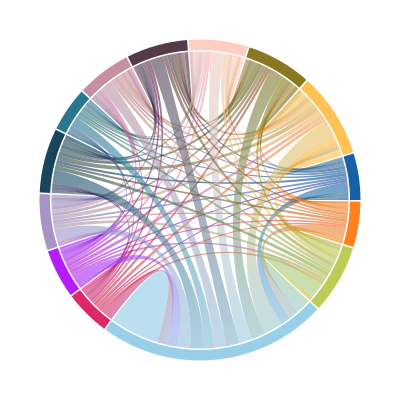

In [128]:
import openchord as ocd


matrix = (np.exp((df_avg_weights_adata1-150)/500)).values.tolist()
names = df_avg_weights_adata1.index.tolist()
fig = ocd.Chord(matrix, names)

fig.colormap = [ 
'#00509d',#Bcell
'#ffbc42',#CD4
'#7c6a0a',#CD8
'#ffc9b9',#DC
'#432534',#EC
'#c08497',#FB
'#126782',#INFg
'#023047',#M1
'#9f86c0',#M2
'#ad03fc',#neutrophil
'#d81159',#stroma
'#8ecae6',#tumor
'#b5c742',#tumor inos
'#FE7206'#unknown
                 ]
fig.font_size =0
fig.radius = 150
fig.padding = 50
fig.show()

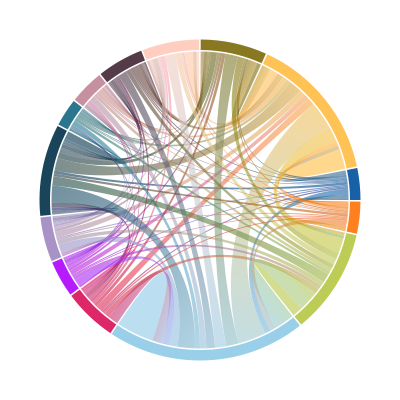

In [129]:
matrix = (np.exp((df_avg_weights_adata2-150)/500)).values.tolist()
names = df_avg_weights_adata2.index.tolist()
fig = ocd.Chord(matrix, names)

fig.colormap = [ 
'#00509d',#Bcell
'#ffbc42',#CD4
'#7c6a0a',#CD8
'#ffc9b9',#DC
'#432534',#EC
'#c08497',#FB
'#126782',#INFg
'#023047',#M1
'#9f86c0',#M2
'#ad03fc',#neutrophil
'#d81159',#stroma
'#8ecae6',#tumor
'#b5c742',#tumor inos
'#FE7206'#unknown
                 ]
fig.font_size =0
fig.radius = 150
fig.padding = 50
fig.show()

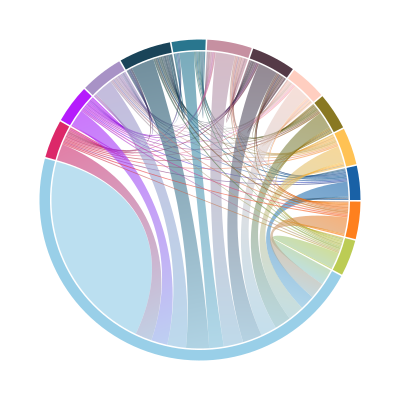

In [130]:
matrix = (np.exp((df_avg_weights_adata3-150)/500)).values.tolist()
names = df_avg_weights_adata3.index.tolist()
fig = ocd.Chord(matrix, names)

fig.colormap = [ 
'#00509d',#Bcell
'#ffbc42',#CD4
'#7c6a0a',#CD8
'#ffc9b9',#DC
'#432534',#EC
'#c08497',#FB
'#126782',#INFg
'#023047',#M1
'#9f86c0',#M2
'#ad03fc',#neutrophil
'#d81159',#stroma
'#8ecae6',#tumor
'#b5c742',#tumor inos
'#FE7206'#unknown
                 ]
fig.font_size =0
fig.radius = 150
fig.padding = 50
fig.show()

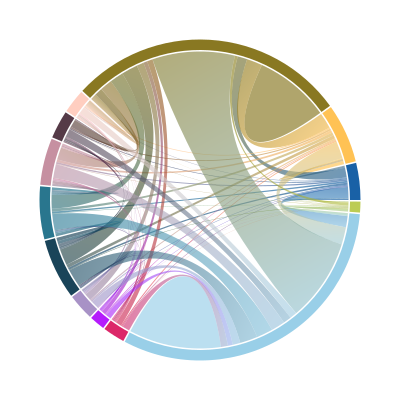

In [131]:
matrix = (np.exp((df_avg_weights_adata4-150)/500)).values.tolist()
names = df_avg_weights_adata4.index.tolist()
fig = ocd.Chord(matrix, names)

fig.colormap = [ 
'#00509d',#Bcell
'#ffbc42',#CD4
'#7c6a0a',#CD8
'#ffc9b9',#DC
'#432534',#EC
'#c08497',#FB
'#126782',#INFg
'#023047',#M1
'#9f86c0',#M2
'#ad03fc',#neutrophil
'#d81159',#stroma
'#8ecae6',#tumor
'#b5c742',#tumor inos
'#FE7206'#unknown
                 ]
fig.font_size =0
fig.radius = 150
fig.padding = 50
fig.show()

In [132]:
pip install cellphonedb

  Obtaining dependency information for cellphonedb from https://files.pythonhosted.org/packages/4a/fc/65f2d348470badbeb1826f0aeef6f84bc5c414cb4946fea0bfab61ede223/cellphonedb-5.0.1-py3-none-any.whl.metadata
  Obtaining dependency information for geosketch>=1.2 from https://files.pythonhosted.org/packages/63/af/5159cc0d7de2260985a78bf973279647d6f58156e7ed2b74f66b5006a925/geosketch-1.3-py3-none-any.whl.metadata
  Obtaining dependency information for ktplotspy>=0.1.4 from https://files.pythonhosted.org/packages/96/a2/d7e393aeb08bb024ebdd09cea7ac2e2fc1e16984fa173cbc2610edfa72ad/ktplotspy-0.2.4-py3-none-any.whl.metadata
  Obtaining dependency information for numpy-groupies>=0.9.15 from https://files.pythonhosted.org/packages/a4/42/230a3fc58aa50ce28649f3f9162d83bbf3d77e29fdd397a4766d8a88409f/numpy_groupies-0.11.2-py3-none-any.whl.metadata
  Obtaining dependency information for pytest>=7.2.0 from https://files.pythonhosted.org/packages/11/92/76a1c94d3afee238333bc0a42b82935dd8f9cf8ce9e336ff87e

/tmp/ipykernel_1611052/2309245185.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_.obs.groupby(['qv_bin', annotation_column])


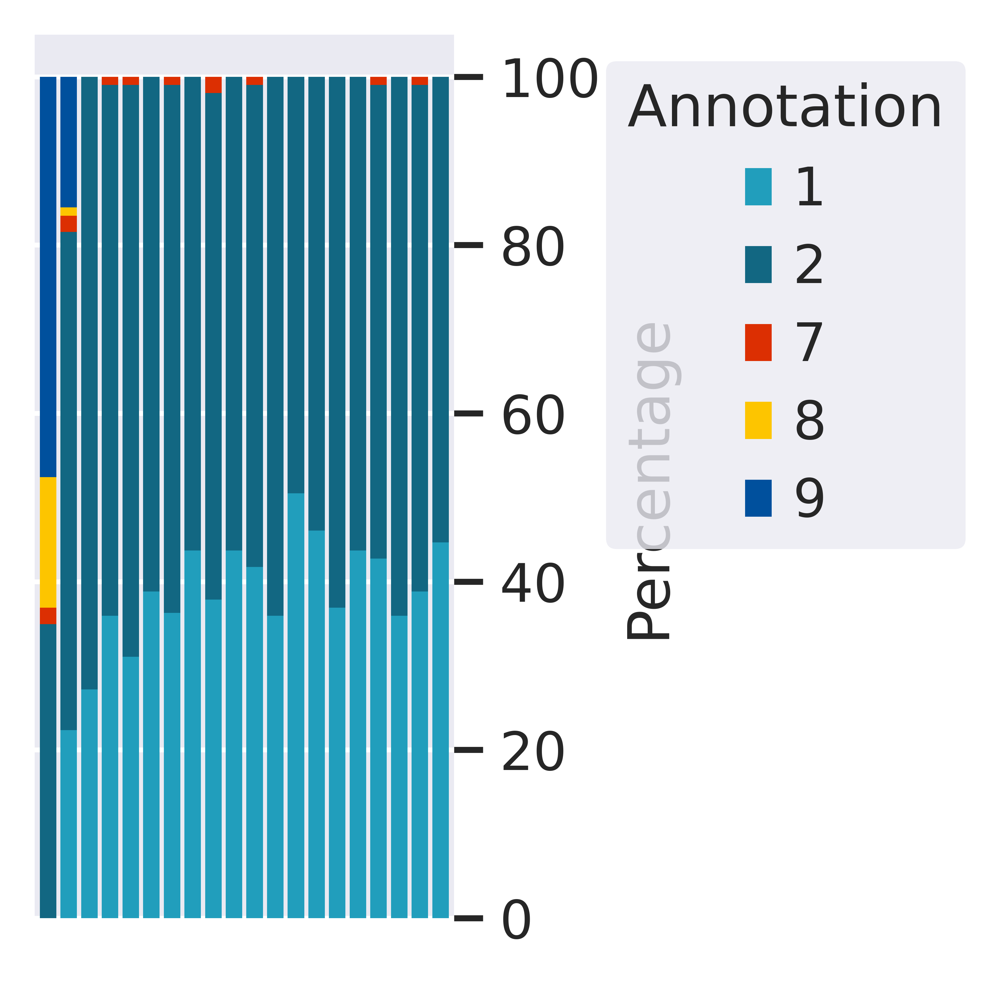

In [57]:
for adata_ in [adata_scRNA1_cut]:

    annotation_column = 'leiden'  # Replace with the actual name of your annotation column


    # Step 1: Bin the qv values into equal-width bins
    adata_.obs['qv_bin'] = pd.qcut(adata_.obsm['v_values'].flatten(), q=20)  # Adjust q for the number of bins

    # Step 2: Calculate the percentage of each annotation in each bin
    percentage_df = (
        adata_.obs.groupby(['qv_bin', annotation_column])
        .size()
        .reset_index(name='count')
        .pivot(index='qv_bin', columns=annotation_column, values='count')
    )

    percentage_df = percentage_df.div(percentage_df.sum(axis=1), axis=0) * 100


    color_mapping = {'Tumor':'#8ecae6',
    'CD8 T cells':'#7c6a0a',
    'INFg+':'#126782',
    'Neutrophils':'#ad03fc',
    'CD4 T cells':'#ffbc42',
    'Stroma Uncharacterized':'#d81159',
    'B cells':'#00509d',
    'Macrophages M2-like':'#9f86c0',
    'Macrophages':'#023047',
    'Fibroblasts':'#c08497',
    'Endothelial cells':'#432534',
    'Dendritic cells':'#ffc9b9',
    'Tumor Inos':'#b5c742',
    'Unknown':'#FE7206'}

    color_mapping = {
    '0':'#8ecae6',
    '1':'#219ebc',
    '2':'#126782',
    '3':'#9f86c0',              
    '4':'#023047',                     
    '5':'#d4e09b',
    '6':'#FE7206',
    '7':'#dc2f02',                                                
    '8':'#fdc500',
    '9':'#00509d',  
        '10':'#d4e09b',
    '11':'#dc2f02',                                                
    '12':'#fdc500',
    '13':'#00509d',
        '14':'#00509d',  
        '15':'#d4e09b',  
    }

    plt.rcParams['axes.edgecolor'] = 'none'  # Remove axis border
    plt.rcParams['patch.linewidth'] = 0    # Remove bar edge lines
    plt.rcParams['figure.facecolor'] = 'white'  # Change background to white

    fig, ax = plt.subplots(figsize=(3.5, 3), dpi=600)
    # Plot the data
    percentage_df.plot(kind='bar', stacked=True, edgecolor=None,color=[color_mapping[col] for col in percentage_df.columns], width=0.8, ax=ax)

    # Move y-axis to the right
    ax.yaxis.set_label_position("right")
    ax.yaxis.tick_right()

    # Customize the plot
    plt.title('')
    ax.set_xlabel('')
    ax.set_ylabel('Percentage')
    plt.legend(title='Annotation', bbox_to_anchor=(1.3, 1), loc='upper left')
    #ax.get_legend().remove()
    plt.xticks([])
    plt.tight_layout()
    plt.show()

/tmp/ipykernel_1611052/2585195680.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_.obs.groupby(['qv_bin', annotation_column])


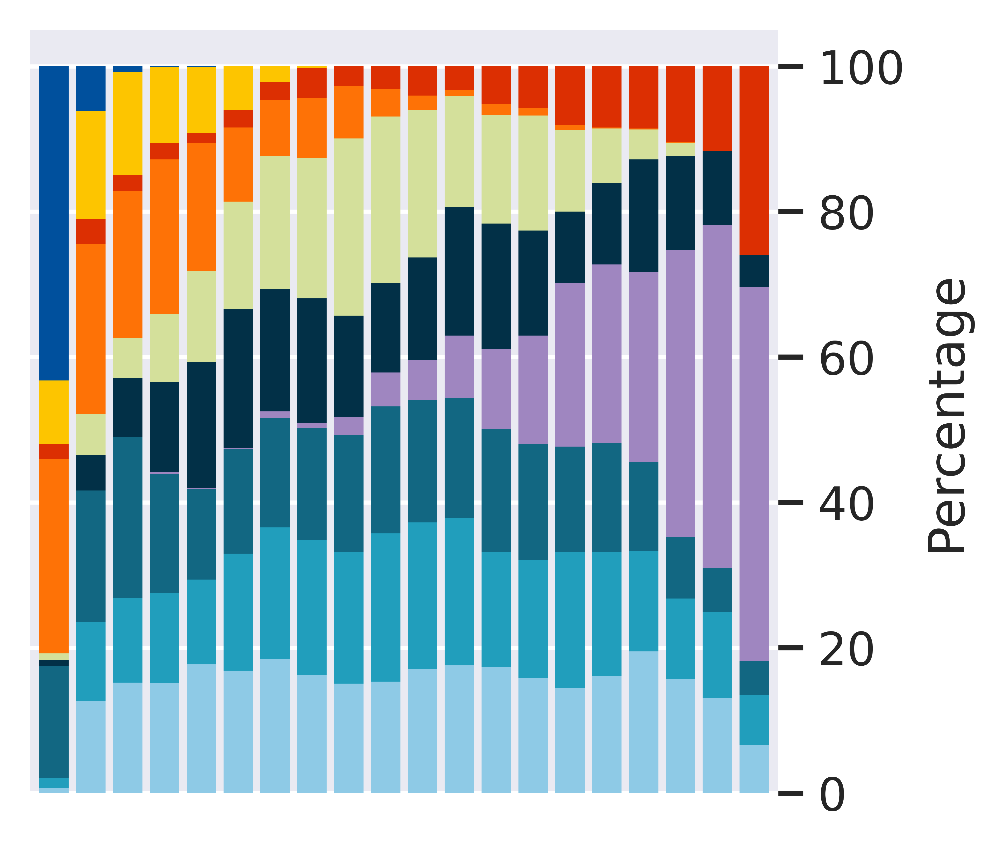

/tmp/ipykernel_1611052/2585195680.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_.obs.groupby(['qv_bin', annotation_column])


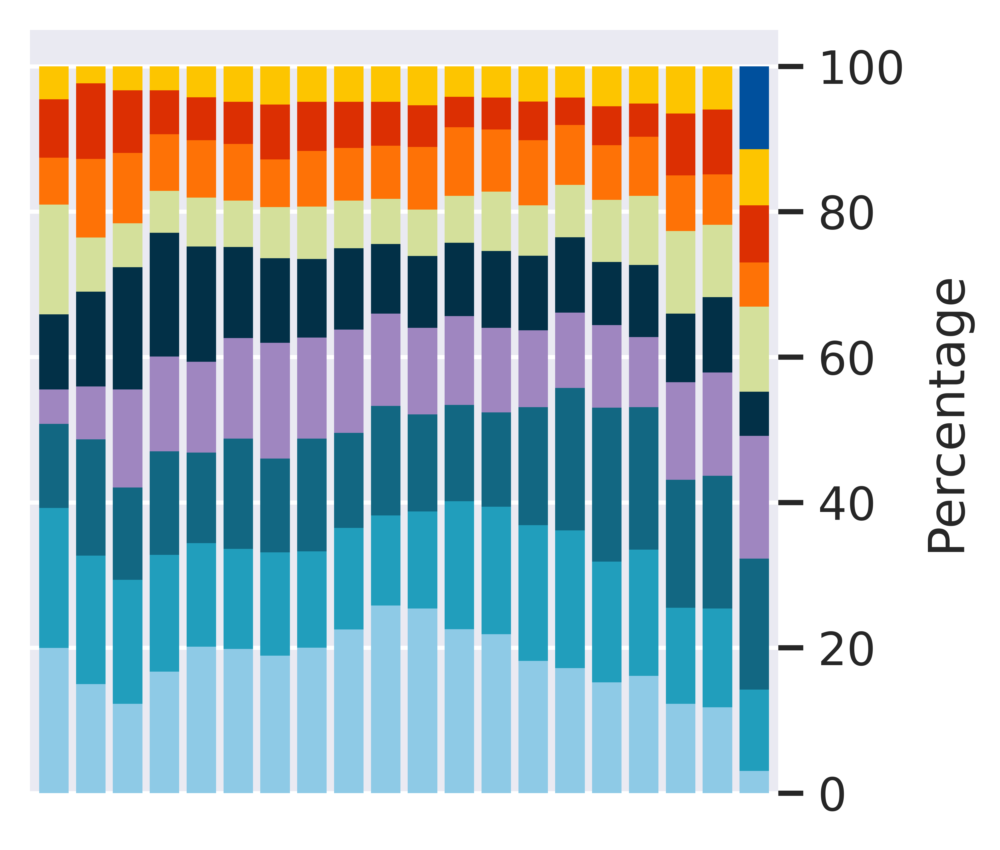

/tmp/ipykernel_1611052/2585195680.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_.obs.groupby(['qv_bin', annotation_column])


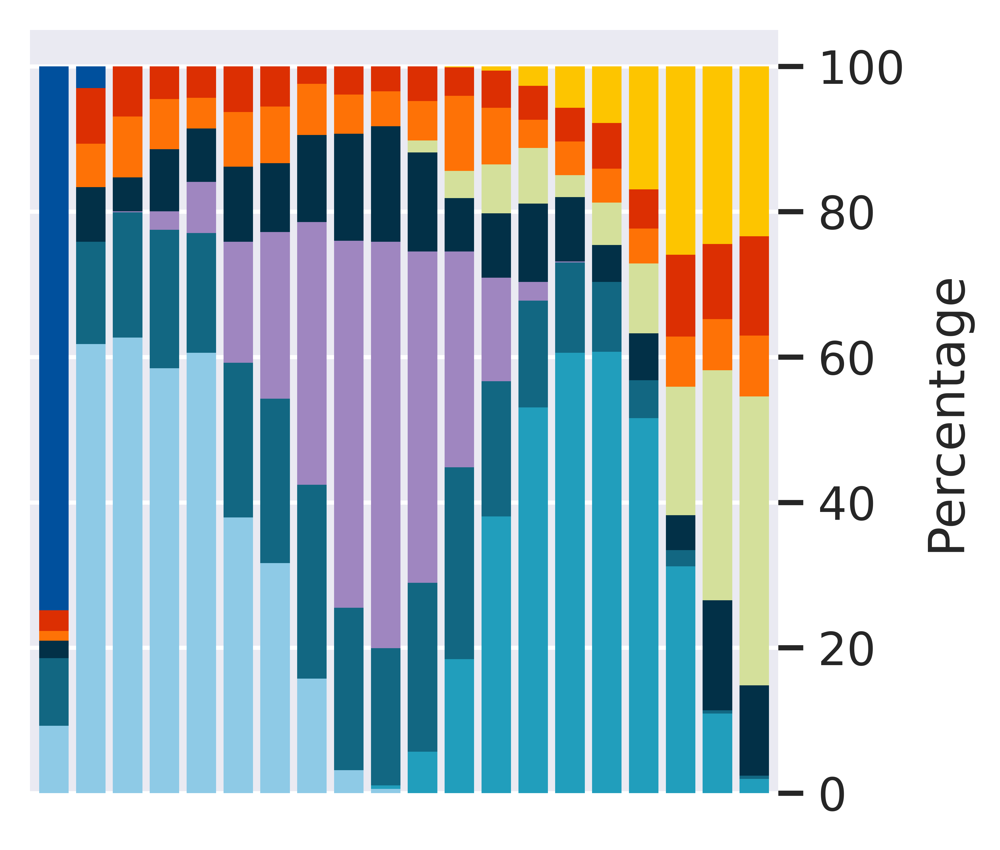

/tmp/ipykernel_1611052/2585195680.py:11: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_.obs.groupby(['qv_bin', annotation_column])


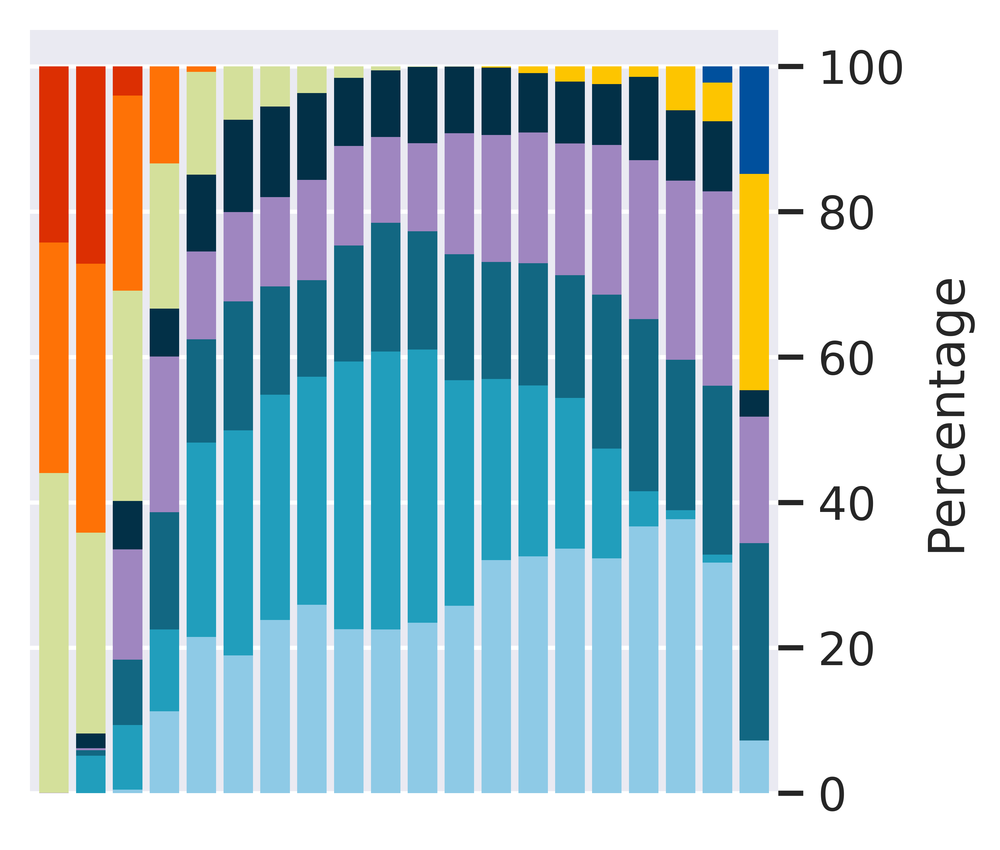

In [41]:
for adata_ in [adata1,adata2,adata3,adata4]:

    annotation_column = 'leiden'  # Replace with the actual name of your annotation column


    # Step 1: Bin the qv values into equal-width bins
    adata_.obs['qv_bin'] = pd.qcut(adata_.obsm['v_values'].flatten(), q=20)  # Adjust q for the number of bins

    # Step 2: Calculate the percentage of each annotation in each bin
    percentage_df = (
        adata_.obs.groupby(['qv_bin', annotation_column])
        .size()
        .reset_index(name='count')
        .pivot(index='qv_bin', columns=annotation_column, values='count')
    )

    percentage_df = percentage_df.div(percentage_df.sum(axis=1), axis=0) * 100


    color_mapping = {'Tumor':'#8ecae6',
    'CD8 T cells':'#7c6a0a',
    'INFg+':'#126782',
    'Neutrophils':'#ad03fc',
    'CD4 T cells':'#ffbc42',
    'Stroma Uncharacterized':'#d81159',
    'B cells':'#00509d',
    'Macrophages M2-like':'#9f86c0',
    'Macrophages':'#023047',
    'Fibroblasts':'#c08497',
    'Endothelial cells':'#432534',
    'Dendritic cells':'#ffc9b9',
    'Tumor Inos':'#b5c742',
    'Unknown':'#FE7206'}

    color_mapping = {
    '0':'#8ecae6',
    '1':'#219ebc',
    '2':'#126782',
    '3':'#9f86c0',              
    '4':'#023047',                     
    '5':'#d4e09b',
    '6':'#FE7206',
    '7':'#dc2f02',                                                
    '8':'#fdc500',
    '9':'#00509d',  
    }

    plt.rcParams['axes.edgecolor'] = 'none'  # Remove axis border
    plt.rcParams['patch.linewidth'] = 0    # Remove bar edge lines
    plt.rcParams['figure.facecolor'] = 'white'  # Change background to white

    fig, ax = plt.subplots(figsize=(3.5, 3), dpi=600)
    # Plot the data
    percentage_df.plot(kind='bar', stacked=True, edgecolor=None,color=[color_mapping[col] for col in percentage_df.columns], width=0.8, ax=ax)

    # Move y-axis to the right
    ax.yaxis.set_label_position("right")
    ax.yaxis.tick_right()

    # Customize the plot
    plt.title('')
    ax.set_xlabel('')
    ax.set_ylabel('Percentage')
    plt.legend(title='Annotation', bbox_to_anchor=(1.3, 1), loc='upper left')
    ax.get_legend().remove()
    plt.xticks([])
    plt.tight_layout()
    plt.show()

In [31]:
adata_scRNA1 = anndata.AnnData(adata1.obsm['generated_expr'])
adata_scRNA1.obs = adata1.obs
adata_scRNA1.obsm = adata1.obsm
adata_scRNA1.var_names = select_gene
adata_scRNA1.raw = adata_scRNA1
sc.pp.normalize_total(adata_scRNA1)
sc.pp.log1p(adata_scRNA1)
sc.tl.pca(adata_scRNA1)

adata_scRNA2 = anndata.AnnData(adata2.obsm['generated_expr'])
adata_scRNA2.obs = adata2.obs
adata_scRNA2.obsm = adata2.obsm
adata_scRNA2.var_names = select_gene
adata_scRNA2.raw = adata_scRNA2
sc.pp.normalize_total(adata_scRNA2)
sc.pp.log1p(adata_scRNA2)
sc.tl.pca(adata_scRNA2)

adata_scRNA3 = anndata.AnnData(adata3.obsm['generated_expr'])
adata_scRNA3.obs = adata3.obs
adata_scRNA3.obsm = adata3.obsm
adata_scRNA3.var_names = select_gene
adata_scRNA3.raw = adata_scRNA3
sc.pp.normalize_total(adata_scRNA3)
sc.pp.log1p(adata_scRNA3)
sc.tl.pca(adata_scRNA3)

adata_scRNA4 = anndata.AnnData(adata4.obsm['generated_expr'])
adata_scRNA4.obs = adata4.obs
adata_scRNA4.obsm = adata4.obsm
adata_scRNA4.var_names = select_gene
adata_scRNA4.raw = adata_scRNA4
sc.pp.normalize_total(adata_scRNA4)
sc.pp.log1p(adata_scRNA4)
sc.tl.pca(adata_scRNA4)

In [40]:
adata1

AnnData object with n_obs × n_vars = 15910 × 51
    obs: 'sample', 'treatment', 'responder', 'leiden', 'cluster', 'codex_type_label', 'niche_classify'
    uns: 'neighbors', 'leiden'
    obsm: 'cell_types', 'codex_true', 'coral', 'generated_expr', 'spatial', 'v_values', 'visium_true'
    obsp: 'distances', 'connectivities'

In [33]:
from scipy.ndimage.filters import gaussian_filter1d
def plot_onco_path_traj(plot_type,_filtered,ylim_l,ylim_r, adata_scRNA):
    data = pd.DataFrame(np.linspace(adata_scRNA.obsm['v_values'].min(),adata_scRNA.obsm['v_values'].max(),200),columns=['time'])
    data_mean_ = []
    data_std_ = []

    colors_ = "#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])

    for i in range(200):

        if i>0:
            temp_ = adata_scRNA.to_df().loc[:,_filtered][(adata_scRNA.obsm['v_values']<=data['time'][i])&
                                                        (adata_scRNA.obsm['v_values']>=data['time'][i-1])
                                                       ].mean(axis=1)
            if len(temp_)>0:
                data_mean_.append(temp_.mean())
                if np.isnan(temp_.std()):
                    data_std_.append(data_std_[-1])
                else:
                    data_std_.append(temp_.std())
            else:
                data_mean_.append(data_mean_[-1])
                data_std_.append(data_std_[-1])
        else:
            data_mean_.append(0)
            data_std_.append(0)

    data_mean_[0] = data_mean_[1]
    data_std_[0] = data_std_[1]
    data['mean'] = data_mean_
    data['std'] = data_std_
    #print(data)
    
    sns.set(style="darkgrid", palette="muted", color_codes=True)
    fig, ax = plt.subplots(figsize=(2.5,1),dpi=900)

    # Smoothing
    Final_array_smooth = gaussian_filter1d(data['mean'], sigma=4)

    # Error formating
    upper_err = gaussian_filter1d(data['mean'] + (data['std']), sigma=10)
    lower_err = gaussian_filter1d(data['mean'] - (data['std']), sigma=10)

    ax.plot(data['time'], data['mean'], '--', linewidth=0.7, color='k', alpha=0.45)

    ax.plot(data['time'], Final_array_smooth,c=colors_)

    ax.fill_between(data['time'], upper_err, lower_err, color=colors_, alpha=0.2)

    ax.set_ylim(np.min(data['mean'])-(np.min((data['mean'])*30)/100), np.max(data['mean'])+(np.max((data['mean'])*30)/100))
    ax.set_ylim([ylim_l,ylim_r])
    #ax.set_xlim([0,1])
    ax.set_xticks([])
    #ax.set_xlabel('Pseudo-time')
    ax.set_ylabel('Score')

/tmp/ipykernel_1611052/1156454439.py:1: DeprecationWarning: Please import `gaussian_filter1d` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  from scipy.ndimage.filters import gaussian_filter1d


In [197]:
adata_all_scRNA

AnnData object with n_obs × n_vars = 113630 × 1046
    obs: 'sample', 'treatment', 'responder', 'leiden', 'cluster', 'codex_type_label', 'niche_classify', 'niche_classify_major'
    uns: 'log1p', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

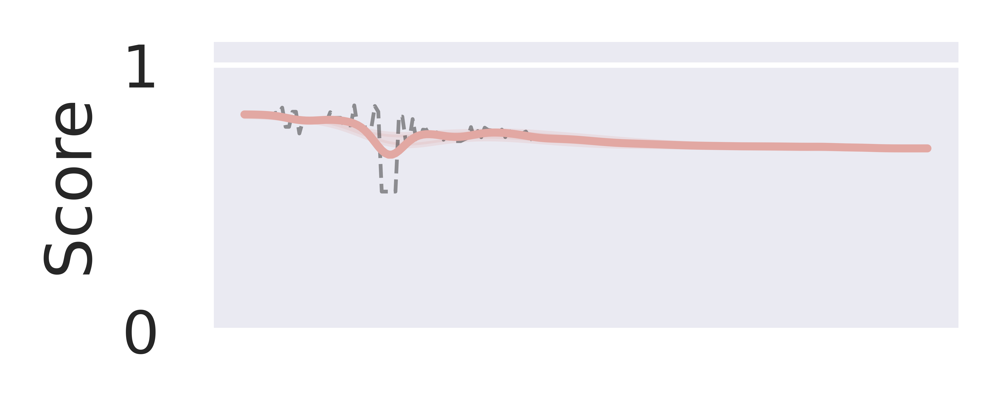

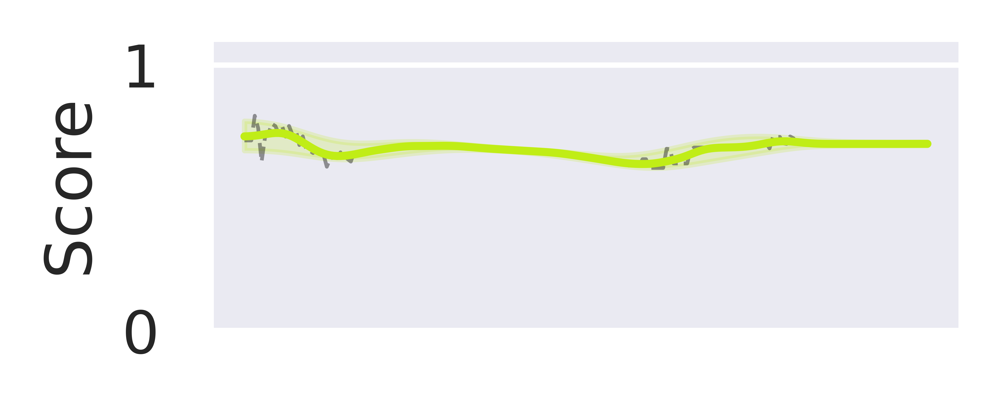

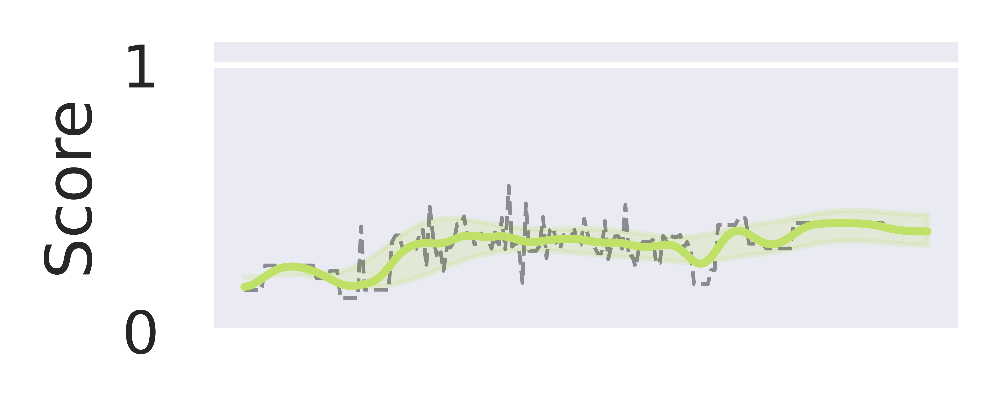

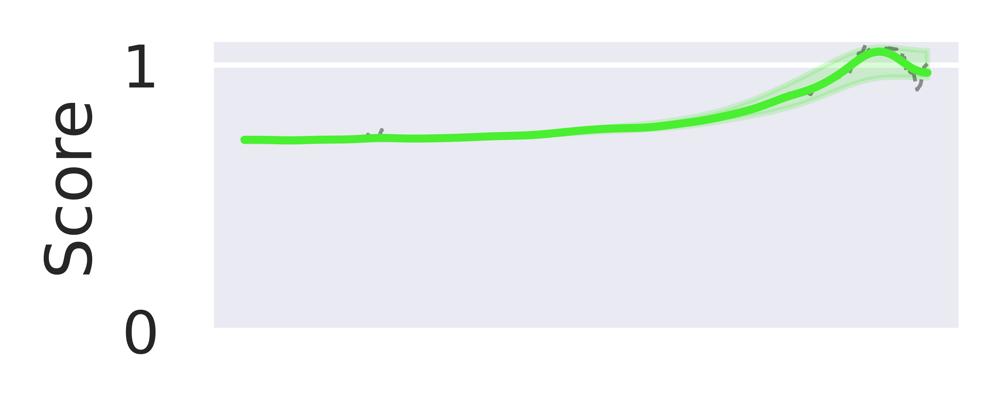

In [221]:
cd8_activation = [
'CD3G', 'FASLG', 'ID2', 'LAG3', 'RGS1', 'CCL3 CCL3L1', 'KIAA1671',
       'SH2D2A', 'DUSP2', 'PDCD1', 'CD7', 'NR4A2', 'CD160', 'PTPN22',
       'ABI3', 'PTGER4', 'GZMK', 'GZMA', 'MBNL1', 'VMP1', 'PLAC8', 'RGS3',
       'EFHD2', 'GLRX', 'CXCR6', 'ARL6IP1', 'CCL4', 'ISG15', 'LAX1',
       'CD8A', 'SERPINA3'
]

gn_filtered = np.intersect1d(cd8_activation,adata_scRNA1[adata_scRNA1.obs.codex_type_label=='CD8 T cells'].var_names)
plot_onco_path_traj('NOTCH',gn_filtered,0,1.1,adata_scRNA1[adata_scRNA1.obs.codex_type_label=='CD8 T cells'])

gn_filtered = np.intersect1d(cd8_activation,adata_scRNA2[adata_scRNA2.obs.codex_type_label=='CD8 T cells'].var_names)
plot_onco_path_traj('NOTCH',gn_filtered,0.,1.1,adata_scRNA2[adata_scRNA2.obs.codex_type_label=='CD8 T cells'])

gn_filtered = np.intersect1d(cd8_activation,adata_scRNA3[adata_scRNA3.obs.codex_type_label=='CD8 T cells'].var_names)
plot_onco_path_traj('NOTCH',gn_filtered,0.,1.1,adata_scRNA3[adata_scRNA3.obs.codex_type_label=='CD8 T cells'])

gn_filtered = np.intersect1d(cd8_activation,adata_scRNA4[adata_scRNA4.obs.codex_type_label=='CD8 T cells'].var_names)
plot_onco_path_traj('NOTCH',gn_filtered,0.,1.1,adata_scRNA4[adata_scRNA4.obs.codex_type_label=='CD8 T cells'])

In [29]:
pd.read_csv('bc_signatures_version_1013.csv')['Treg'].values

array(['TNFRSF4', 'LTB', 'IL32', 'BATF', 'FOXP3', 'TIGIT', 'TNFRSF18',
       'CTLA4', 'CARD16', 'TRAC', 'IL2RA', 'CD27', 'DUSP4', 'ICOS', 'CD2',
       'PMAIP1', 'RGS1', 'AC133644.2', 'TNFRSF9', 'TNFRSF1B', 'SPOCK2',
       'TBC1D4', 'IL2RG', 'BIRC3', 'S100A4', 'RTKN2', 'CD7', 'ARID5B',
       'GK', 'CD3D', 'TRBC2', 'TRBC1', 'CREM', 'CYTIP', 'SAMSN1', 'PIM2',
       'SH2D2A', 'GBP5', 'CD3E', 'STK17B', 'PTPRC', 'RAC2', 'IKZF2',
       'LCK', 'PELI1', 'CACYBP', 'SOD1', 'LAT', 'MAGEH1', 'RHOH',
       'CLEC2D', 'SKAP1', 'ARHGDIB', 'SELL', 'PRDM1', 'ISG20', 'CORO1A',
       'CORO1B', 'STK4', 'LAIR2', 'BTG1', 'PHLDA1', nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan], dtype=object)

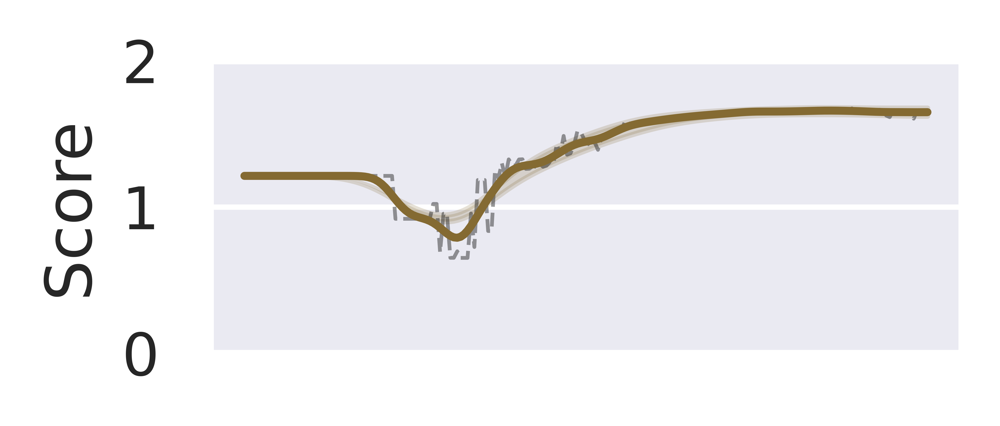

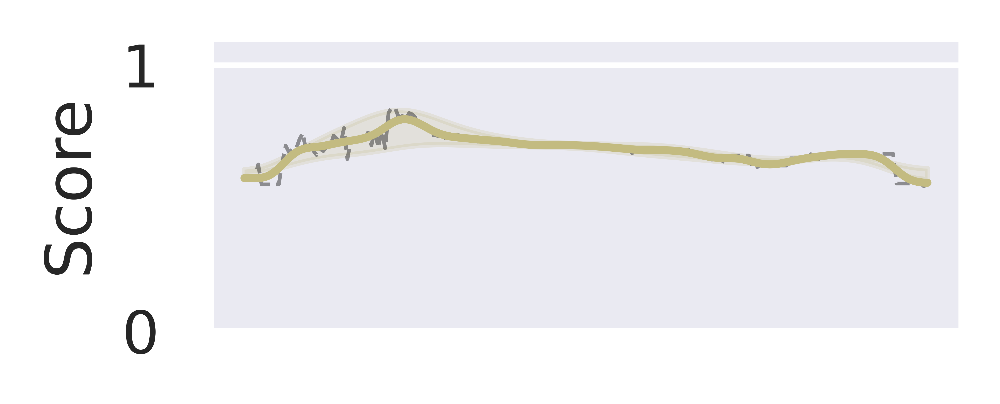

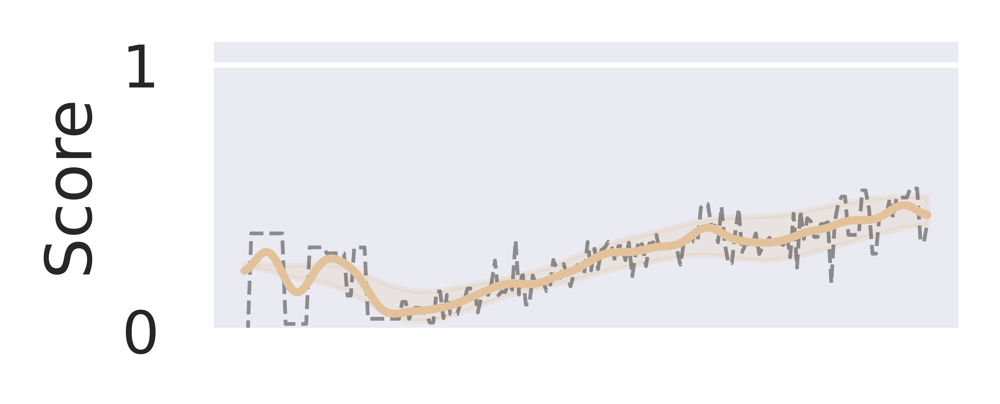

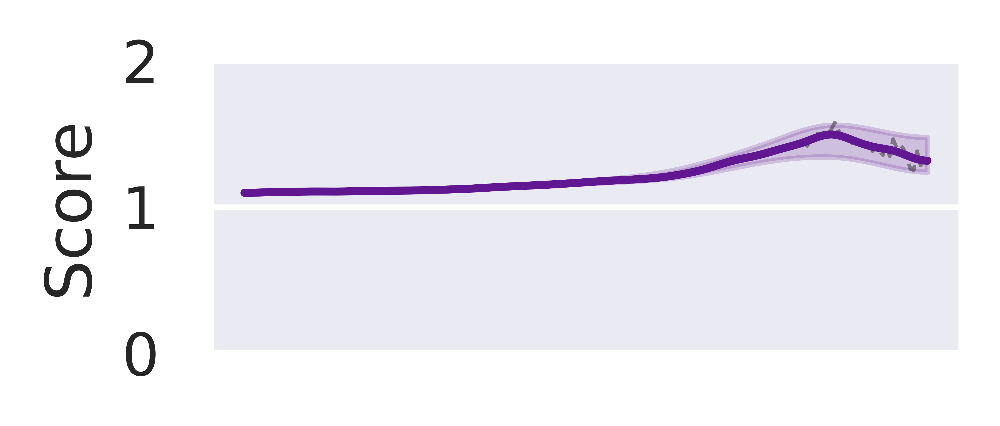

In [35]:
cd8_activation = [
'TNFRSF4', 'LTB', 'IL32', 'BATF', 'FOXP3', 'TIGIT', 'TNFRSF18',
       'CTLA4', 'CARD16', 'TRAC', 'IL2RA', 'CD27', 'DUSP4', 'ICOS', 'CD2',
       'PMAIP1', 'RGS1', 'AC133644.2', 'TNFRSF9', 'TNFRSF1B', 'SPOCK2',
       'TBC1D4', 'IL2RG', 'BIRC3', 'S100A4', 'RTKN2', 'CD7', 'ARID5B',
       'GK', 'CD3D', 'TRBC2', 'TRBC1', 'CREM', 'CYTIP', 'SAMSN1', 'PIM2',
       'SH2D2A', 'GBP5', 'CD3E', 'STK17B', 'PTPRC', 'RAC2', 'IKZF2',
       'LCK', 'PELI1', 'CACYBP', 'SOD1', 'LAT', 'MAGEH1', 'RHOH',
       'CLEC2D', 'SKAP1', 'ARHGDIB', 'SELL', 'PRDM1', 'ISG20', 'CORO1A',
       'CORO1B', 'STK4', 'LAIR2', 'BTG1', 'PHLDA1',]
gn_filtered = np.intersect1d(cd8_activation,adata_scRNA1[adata_scRNA1.obs.codex_type_label.isin(['CD4 T cells'])].var_names)
plot_onco_path_traj('NOTCH',gn_filtered,0,2,adata_scRNA1[adata_scRNA1.obs.codex_type_label.isin(['CD4 T cells'])])

gn_filtered = np.intersect1d(cd8_activation,adata_scRNA2[adata_scRNA2.obs.codex_type_label.isin(['CD4 T cells'])].var_names)
plot_onco_path_traj('NOTCH',gn_filtered,0.,1.1,adata_scRNA2[adata_scRNA2.obs.codex_type_label.isin(['CD4 T cells'])])

gn_filtered = np.intersect1d(cd8_activation,adata_scRNA3[adata_scRNA3.obs.codex_type_label.isin(['CD4 T cells'])].var_names)
plot_onco_path_traj('NOTCH',gn_filtered,0.,1.1,adata_scRNA3[adata_scRNA3.obs.codex_type_label.isin(['CD4 T cells'])])

gn_filtered = np.intersect1d(cd8_activation,adata_scRNA4[adata_scRNA4.obs.codex_type_label.isin(['CD4 T cells'])].var_names)
plot_onco_path_traj('NOTCH',gn_filtered,0.,2,adata_scRNA4[adata_scRNA4.obs.codex_type_label.isin(['CD4 T cells'])])

(array([3.000e+00, 4.100e+01, 1.590e+02, 4.440e+02, 1.481e+03, 4.091e+03,
        4.391e+03, 4.182e+03, 1.006e+03, 1.120e+02]),
 array([-5.42198849, -4.60163641, -3.78128409, -2.96093202, -2.1405797 ,
        -1.32022762, -0.49987546,  0.32047671,  1.14082885,  1.96118104,
         2.78153324]),
 <BarContainer object of 10 artists>)

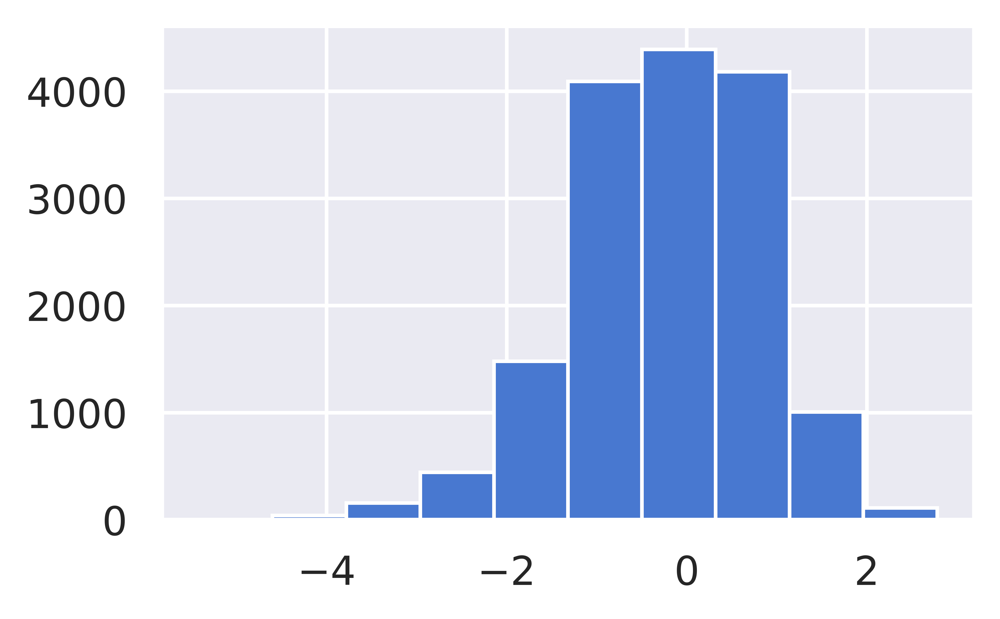

In [218]:
plt.hist(adata_scRNA1.obsm['v_values'])

In [219]:
adata_scRNA1.to_df()

,A4GNT,ABCG2,ABHD15,ABHD18,AC004593.3,AC011005.1,AC072022.2,AC099489.1,AC233723.1,ACAA1,...,ZNF792,ZNF823,ZNHIT2,ZPBP2,ZSCAN18,ZSCAN25,ZSCAN30,ZSWIM2,ZSWIM4,ZYG11B
1,0.620313,0.658757,0.781137,0.743505,0.409075,0.425037,0.609960,0.621725,0.646105,0.868832,...,0.629532,0.631042,0.636369,0.505392,0.756158,0.666656,0.709329,0.476750,0.724872,0.762983
2,0.665444,0.639757,0.764406,0.736154,0.409936,0.408641,0.646351,0.628660,0.625503,0.868643,...,0.637449,0.639219,0.610685,0.484024,0.758275,0.682737,0.709117,0.455841,0.714627,0.763536
4,0.529434,0.717318,0.772396,0.762614,0.533720,0.384141,0.407717,0.587623,0.559836,0.920097,...,0.696532,0.658299,0.705624,0.533063,0.794141,0.691454,0.684575,0.447904,0.690746,0.771678
5,0.515114,0.778024,0.824896,0.789268,0.437064,0.302518,0.286890,0.585933,0.513097,0.990173,...,0.748121,0.611865,0.790868,0.564619,0.839755,0.735769,0.726581,0.450255,0.716878,0.827293
7,0.525403,0.762060,0.813450,0.781870,0.457610,0.326022,0.330896,0.582242,0.531067,0.975742,...,0.740795,0.622941,0.775643,0.583472,0.828679,0.732700,0.714077,0.446666,0.722402,0.812666
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16545,0.649027,0.666545,0.698035,0.682458,0.638440,0.646740,0.664225,0.658349,0.655172,0.746525,...,0.670467,0.679305,0.661050,0.657337,0.687982,0.682965,0.677877,0.635076,0.676602,0.674965
16546,0.656905,0.668656,0.692535,0.675152,0.669117,0.673704,0.658917,0.676871,0.682210,0.703171,...,0.687026,0.681534,0.668359,0.674552,0.664647,0.686738,0.670060,0.663147,0.693011,0.664319
16547,0.654396,0.668754,0.692849,0.675715,0.669521,0.675336,0.658985,0.676089,0.681851,0.704144,...,0.687005,0.681857,0.668089,0.676023,0.665166,0.686456,0.670116,0.661365,0.692865,0.664403
16548,0.663025,0.666905,0.693148,0.673375,0.669003,0.671475,0.663085,0.677636,0.679536,0.707419,...,0.685620,0.683068,0.668248,0.678084,0.666231,0.686022,0.670778,0.672753,0.690182,0.662519


In [231]:
import decoupler as dc
progeny = dc.get_progeny(organism='human', top=1000)
progeny


,source,target,weight,p_value
0,Androgen,TMPRSS2,11.490631,0.000000e+00
1,Androgen,NKX3-1,10.622551,2.242078e-44
2,Androgen,MBOAT2,10.472733,4.624285e-44
3,Androgen,KLK2,10.176186,1.944414e-40
4,Androgen,SARG,11.386852,2.790209e-40
...,...,...,...,...
13995,p53,PABPC4,-2.282467,6.623818e-05
13996,p53,SF3B3,-1.615436,6.641896e-05
13997,p53,RNF26,-2.288269,6.643224e-05
13998,p53,RABL6,-1.156483,6.697673e-05


In [49]:
adata_scRNA1_cut = adata_scRNA1[adata_scRNA1.obs.codex_type_label.isin(['Macrophages M2-like', 'Macrophages'])].copy()

dc.run_mlm(
    mat=adata_scRNA1_cut,
    net=progeny,
    source='source',
    target='target',
    weight='weight',
    verbose=True
)

Running mlm on mat with 2058 samples and 1046 targets for 14 sources.


In [50]:
adata_scRNA1_cut.obsm['progeny_mlm_estimate'] = adata_scRNA1_cut.obsm['mlm_estimate'].copy()
adata_scRNA1_cut.obsm['progeny_mlm_pvals'] = adata_scRNA1_cut.obsm['mlm_pvals'].copy()
adata_scRNA1_cut

AnnData object with n_obs × n_vars = 2058 × 1046
    obs: 'sample', 'treatment', 'responder', 'leiden', 'cluster', 'codex_type_label', 'niche_classify', 'qv_bin'
    uns: 'log1p', 'pca'
    obsm: 'cell_types', 'codex_true', 'coral', 'generated_expr', 'spatial', 'v_values', 'visium_true', 'X_pca', 'mlm_estimate', 'mlm_pvals', 'progeny_mlm_estimate', 'progeny_mlm_pvals'
    varm: 'PCs'

In [51]:
adata_scRNA1.obs['codex_type_label'].unique()

array(['CD4 T cells', 'Neutrophils', 'Tumor Inos', 'Fibroblasts', 'Tumor',
       'Macrophages M2-like', 'Macrophages', 'Endothelial cells',
       'CD8 T cells', 'Dendritic cells', 'Unknown', 'B cells',
       'Stroma Uncharacterized', 'INFg+'], dtype=object)

In [52]:
acts = dc.get_acts(adata_scRNA1_cut, obsm_key='mlm_estimate')
acts

AnnData object with n_obs × n_vars = 2058 × 14
    obs: 'sample', 'treatment', 'responder', 'leiden', 'cluster', 'codex_type_label', 'niche_classify', 'qv_bin'
    uns: 'log1p', 'pca'
    obsm: 'cell_types', 'codex_true', 'coral', 'generated_expr', 'spatial', 'v_values', 'visium_true', 'X_pca', 'mlm_estimate', 'mlm_pvals', 'progeny_mlm_estimate', 'progeny_mlm_pvals'

In [53]:
sc.pl.matrixplot(acts, var_names=acts.var_names, groupby='qv_bin', dendrogram=False, standard_scale='var',
                 colorbar_title='Z-scaled scores', cmap='coolwarm')

(array([ 13.,  24.,  54.,  70., 251., 429., 617., 489., 105.,   6.]),
 array([-4.74896717, -4.03595829, -3.32294893, -2.60994005, -1.89693093,
        -1.18392181, -0.47091275,  0.24209633,  0.95510542,  1.66811442,
         2.38112354]),
 <BarContainer object of 10 artists>)

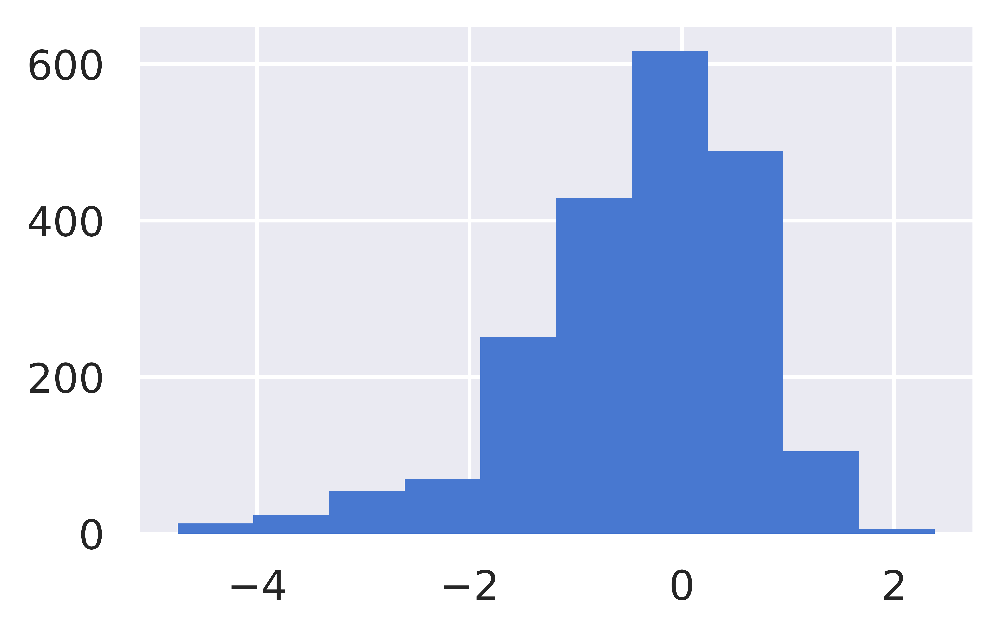

In [56]:
plt.hist(adata_scRNA1_cut.obsm['v_values'])